In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Topic: EX2 - Turbofan RUL Prediction
**Task**: Predict the remaining useful life (RUL) of turbofan engines based on given sensor data (time series data). It is a regression problem.
**Data**: Turbofan engine degradation simulation data (NASA) - [Link](https://data.nasa.gov/dataset/Turbofan-Engine-Degradation-Simulation-Data-Set/vrks-gjie). See also in the topic [introduction notebook](https://github.com/nina-prog/damage-propagation-modeling/blob/2fb8c1a1102a48d7abbf04e4031807790a913a99/notebooks/Turbofan%20remaining%20useful%20life%20Prediction.ipynb).

**Subtasks**:
1. Perform a deep **exploratory data analysis (EDA)** on the given data. -> 🎯 **Focus on this task**
2. Implement a more efficient **sliding window method** for time series data analysis. 
3. Apply **traditional machine learning methods** (SOTA) to predict the remaining useful life. Includes data preparation, feature extraction, feature selection, model selection, and model parameter optimization.
4. Create **neural network models** to predict the remaining useful life. Includes different architectures like Convolutional Neural Networks (CNN), Recurrent Neural Networks (RNN), or Attention Models. Note: You can search for SOTA research papers and reproduce current state-of-the-art models.


# Imports + Settings

In [3]:
# third-party libraries
import pandas as pd
import numpy as np
import os

import time
from tqdm.notebook import tqdm

import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns

In [27]:
# source code
from src.utils import load_data, load_config
from src.plotting import plot_sensor_measures_from_motor, plot_sensor_measures_from_dataset, plot_single_sensor_measure_from_dataset

In [5]:
# settings
sns.set_style("whitegrid")
sns.set_palette("Set2")
sns.set(rc={"figure.dpi":100, 'savefig.dpi':200})
sns.set_context('notebook')

In [6]:
np.random.seed(42)

# Paths

In [7]:
# Make sure to execute this cell only once for one kernel session, before running any other cell below.
os.chdir("../") # set working directory to root of project
os.getcwd() # check current working directory

'C:\\Users\\Johannes\\PycharmProjects\\damage-propagation-modeling'

In [8]:
PATH_TO_CONFIG = "configs/config.yaml"

# Load Config + Data

In [9]:
config = load_config(PATH_TO_CONFIG) # config is dict

In [10]:
train_data_1, test_data_1, test_RUL_data_1 = load_data(config_path=PATH_TO_CONFIG, dataset_num=1)

2024-05-26 10:33:45 [src.utils:60] [INFO] >>>> Loading data set 1...
2024-05-26 10:33:46 [src.utils:89] [INFO] >>>> Loaded raw data for dataset 1.
2024-05-26 10:33:46 [src.utils:90] [INFO] >>>> Train Data: (20631, 26)
2024-05-26 10:33:46 [src.utils:91] [INFO] >>>> Test Data: (13096, 26)
2024-05-26 10:33:46 [src.utils:92] [INFO] >>>> Test RUL Data: (100, 1)


In [11]:
train_data_2, test_data_2, test_RUL_data_2 = load_data(config_path=PATH_TO_CONFIG, dataset_num=2)

2024-05-26 10:33:46 [src.utils:60] [INFO] >>>> Loading data set 2...
2024-05-26 10:33:47 [src.utils:89] [INFO] >>>> Loaded raw data for dataset 2.
2024-05-26 10:33:47 [src.utils:90] [INFO] >>>> Train Data: (53759, 26)
2024-05-26 10:33:47 [src.utils:91] [INFO] >>>> Test Data: (33991, 26)
2024-05-26 10:33:47 [src.utils:92] [INFO] >>>> Test RUL Data: (259, 1)


In [12]:
train_data_3, test_data_3, test_RUL_data_3 = load_data(config_path=PATH_TO_CONFIG, dataset_num=3)

2024-05-26 10:33:47 [src.utils:60] [INFO] >>>> Loading data set 3...
2024-05-26 10:33:48 [src.utils:89] [INFO] >>>> Loaded raw data for dataset 3.
2024-05-26 10:33:48 [src.utils:90] [INFO] >>>> Train Data: (24720, 26)
2024-05-26 10:33:48 [src.utils:91] [INFO] >>>> Test Data: (16596, 26)
2024-05-26 10:33:48 [src.utils:92] [INFO] >>>> Test RUL Data: (100, 1)


In [13]:
train_data_4, test_data_4, test_RUL_data_4 = load_data(config_path=PATH_TO_CONFIG, dataset_num=4)

2024-05-26 10:33:48 [src.utils:60] [INFO] >>>> Loading data set 4...
2024-05-26 10:33:49 [src.utils:89] [INFO] >>>> Loaded raw data for dataset 4.
2024-05-26 10:33:49 [src.utils:90] [INFO] >>>> Train Data: (61249, 26)
2024-05-26 10:33:49 [src.utils:91] [INFO] >>>> Test Data: (41214, 26)
2024-05-26 10:33:49 [src.utils:92] [INFO] >>>> Test RUL Data: (248, 1)


In [14]:
train_data = [train_data_1, train_data_2, train_data_3, train_data_4]
test_data = [test_data_1, test_data_2, test_data_3, test_data_4]

# 📍 Subtask 1: Exploratory Data Analysis

In [15]:
# Add RUL to train datasets
from src.rolling_window_creator import calculate_RUL

time_column = 'Cycle'
group_column = 'UnitNumber'

train_data = [calculate_RUL(train_data_1, time_column, group_column), calculate_RUL(train_data_2, time_column, group_column), calculate_RUL(train_data_3, time_column, group_column), calculate_RUL(train_data_4, time_column, group_column)]
train_data_1 = train_data[0]
train_data_2 = train_data[1]
train_data_3 = train_data[2]
train_data_4 = train_data[3]

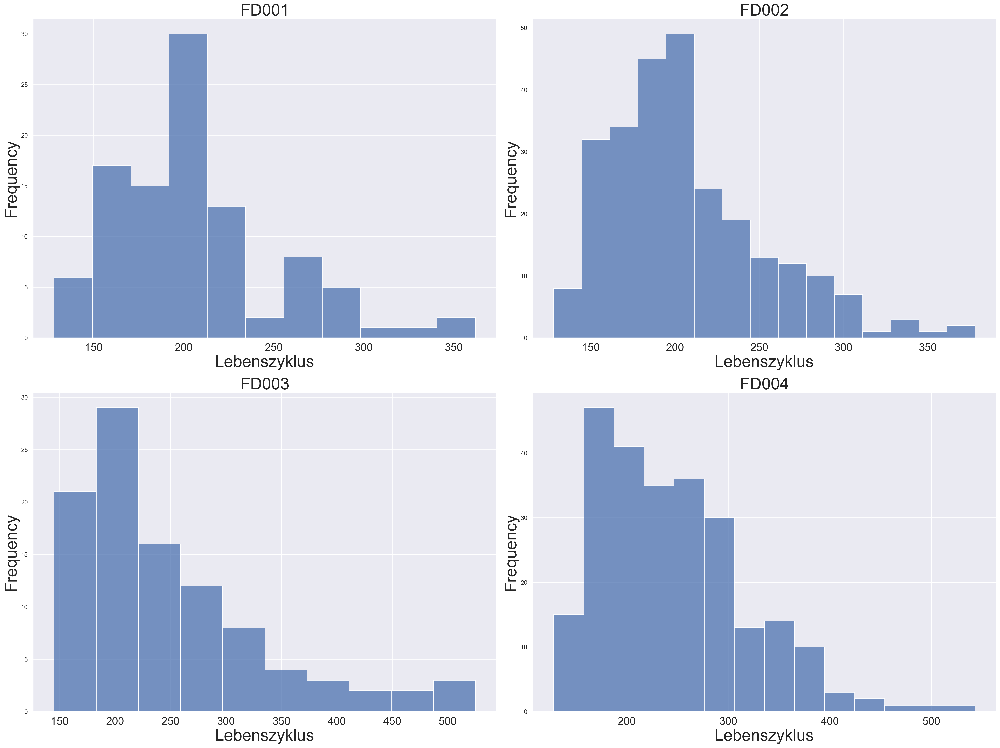

In [16]:
sqr_n= round(np.sqrt(len(train_data)))
plt.figure(figsize=(25.6, 19.2))
for i, train_data_x in enumerate(train_data):
    plt.subplot(sqr_n,sqr_n,i + 1)
    sns.histplot(x=train_data_x.groupby('UnitNumber')['RUL'].max(), bins='auto')
    plt.title('FD00' + str(i + 1), fontsize=30)  
    plt.xlabel('Lebenszyklus', fontsize=30)
    plt.ylabel('Frequency', fontsize=30)  
    plt.xticks(fontsize=20)
plt.tight_layout()
plt.show()

Findings: 
* The distributions of life cycles in the four datasets are not the same, but they are very similar.
* Some of the motors in datasets in fault mode (FD003 and FD004) two reach much higher life cycles.

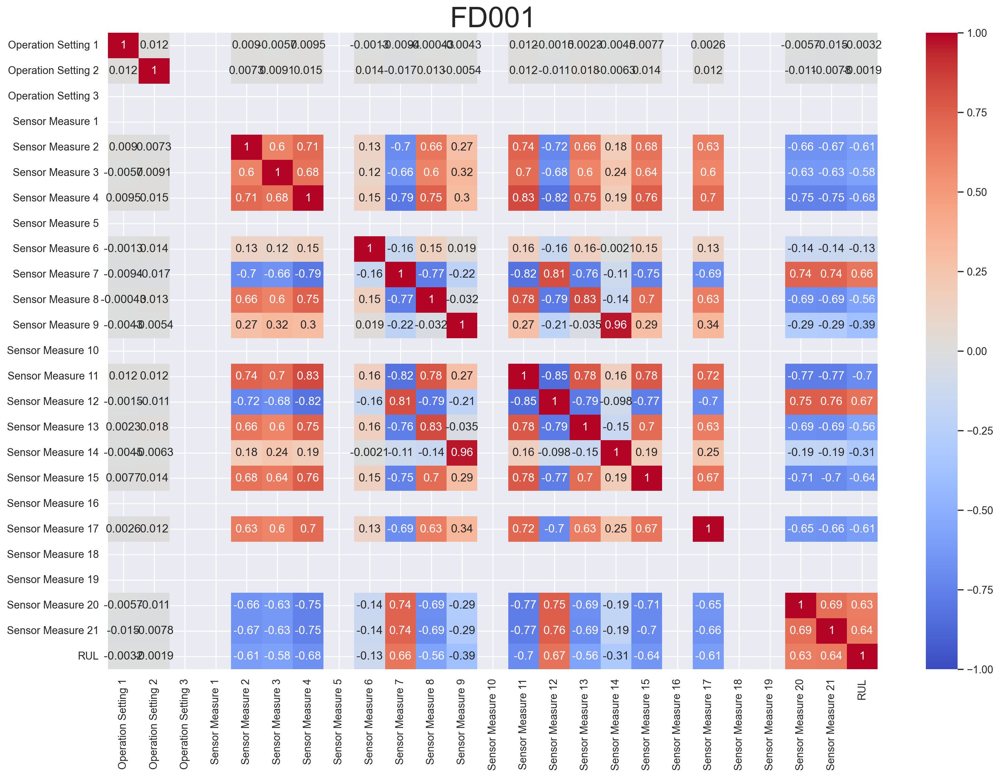

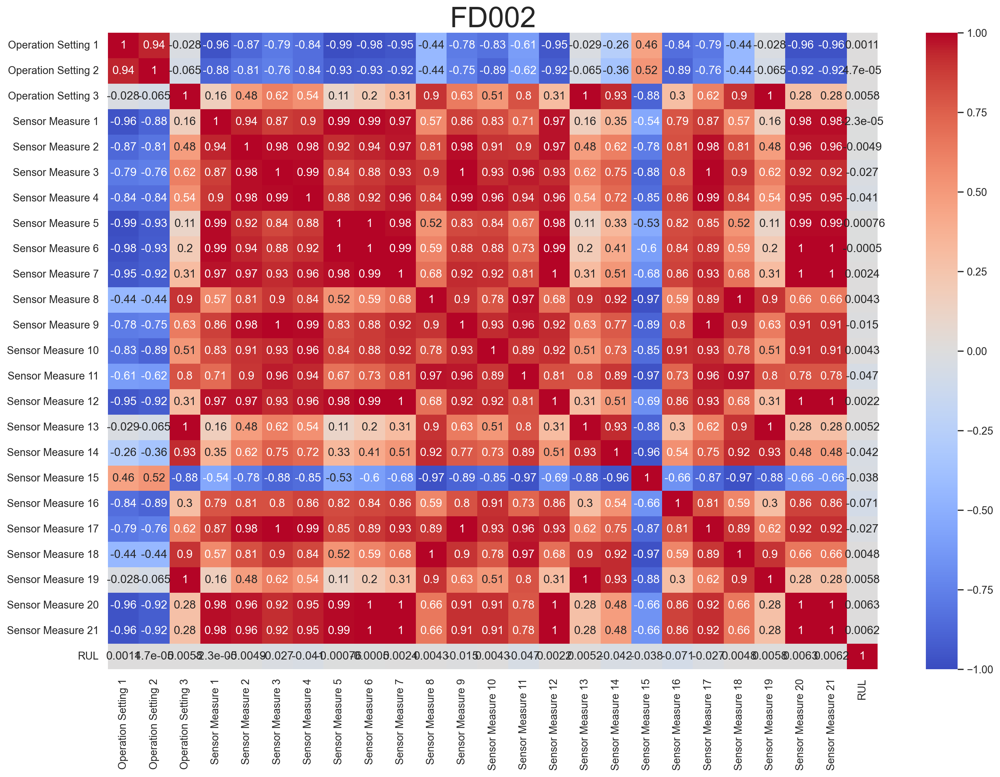

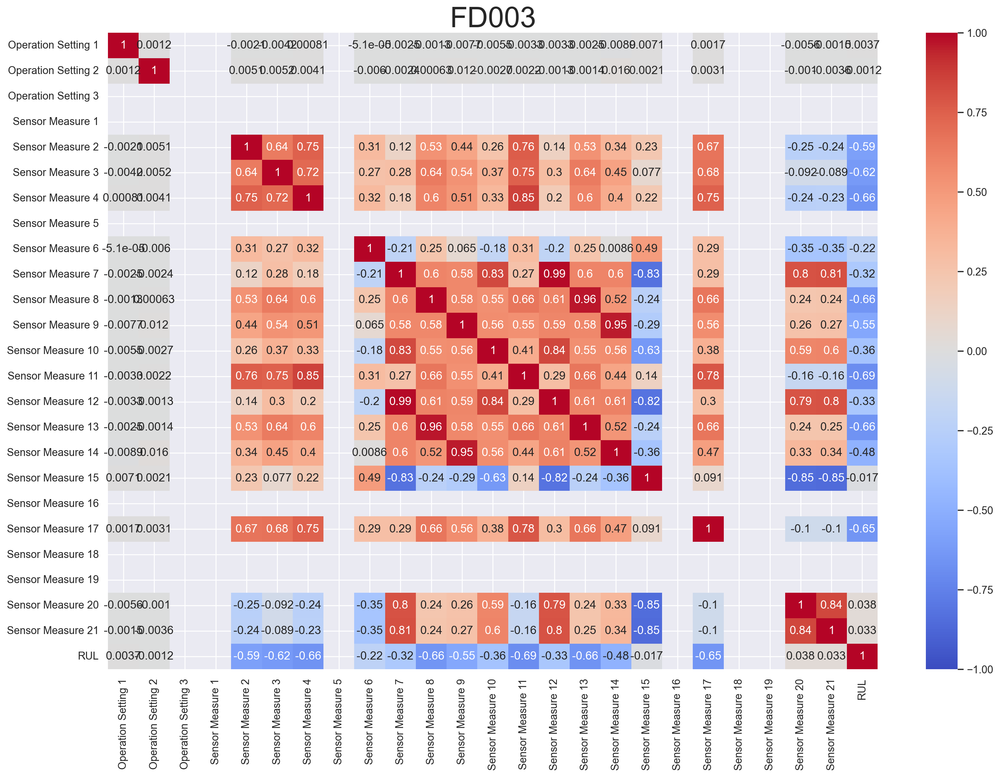

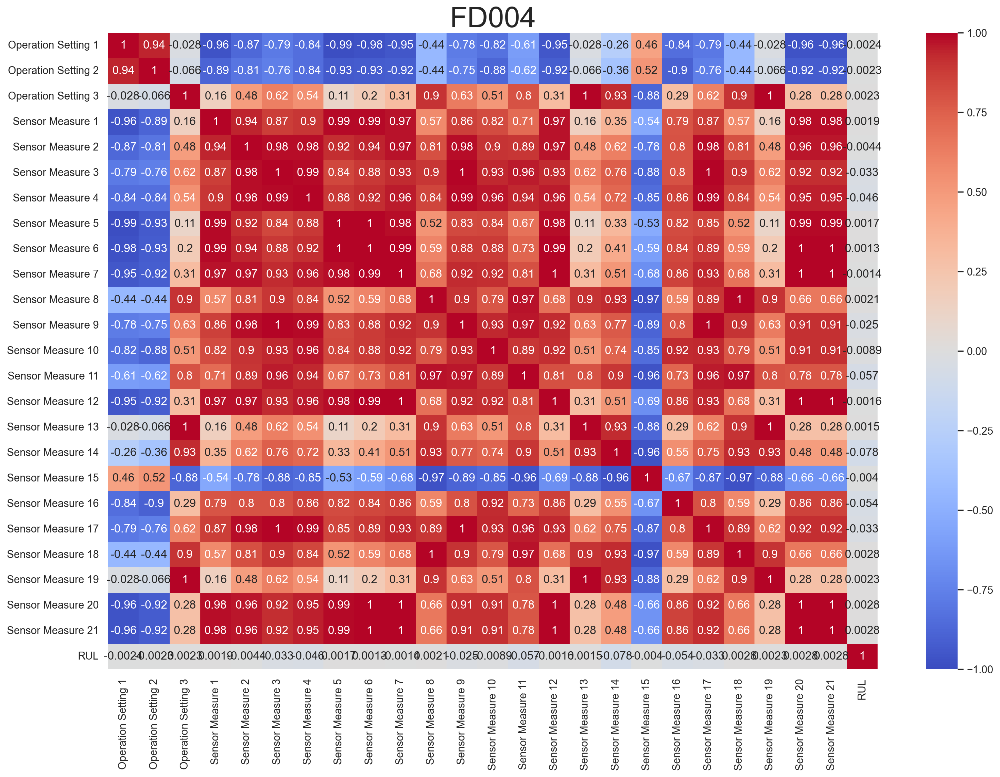

In [17]:
for i, train_data_x in enumerate(train_data):
    correlation = train_data_x.drop(['UnitNumber', 'Cycle'], axis=1).corr()
    
    fig = plt.figure(figsize = (18,12))
    sns.heatmap(correlation, annot=True, vmin=-1, vmax=1, cmap="coolwarm")
    plt.title('FD00' + str(i + 1), fontsize=30)

Text(0.5, 1.0, 'FD001 and FD003 correlation with RUL')

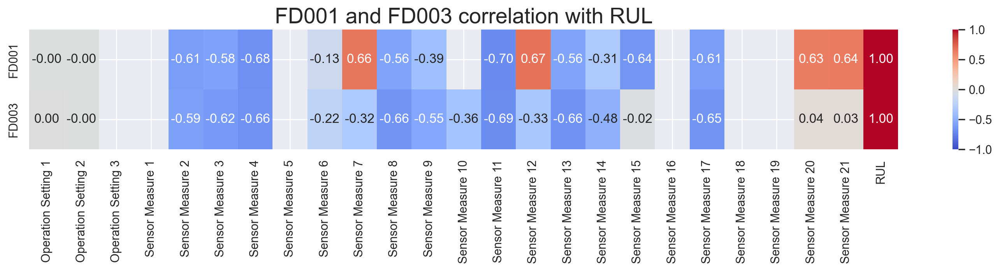

In [49]:
correlation_1 = train_data_1.drop(['UnitNumber', 'Cycle'], axis=1).corr()
correlation_3 = train_data_3.drop(['UnitNumber', 'Cycle'], axis=1).corr()

columns = pd.Index(['Dataset'])
columns.append(correlation_1.columns)
df_rul_1_3 = pd.DataFrame(columns=columns)
df_rul_1_3['FD001'] = correlation_1['RUL']
df_rul_1_3['FD003'] = correlation_3['RUL']

fig = plt.figure(figsize = (18,2))
sns.heatmap(df_rul_1_3[df_rul_1_3.columns.drop('Dataset')].transpose(), fmt=".2f", annot=True, vmin=-1, vmax=1, cmap="coolwarm")
plt.title('FD001 and FD003 correlation with RUL', fontsize=20)

Findings:
* The correlation from the datasets under condition SIX (FD002 and FD004) vary significantly compared to the datasets under condition ONE for the attributes: 'Operation Setting 3', 'Sensor Measure 1', 'Sensor Measure 5', 'Sensor Measure 16', 'Sensor Measure 18', 'Sensor Measure 19'
* Especially the correlation with the RUL is significantly lower in the datasets under condition SIX
* The features of the datasets under condition SIX have nearly no correlation (not a high positive or negative correlation) with the RUL. 
* The correlation between RUL and features of FD001 and FD003 vary also for some measures significantly, e.g. Sensor Measure 20 and 21

Text(0.5, 1.0, 'FD002 and FD004 correlation with RUL')

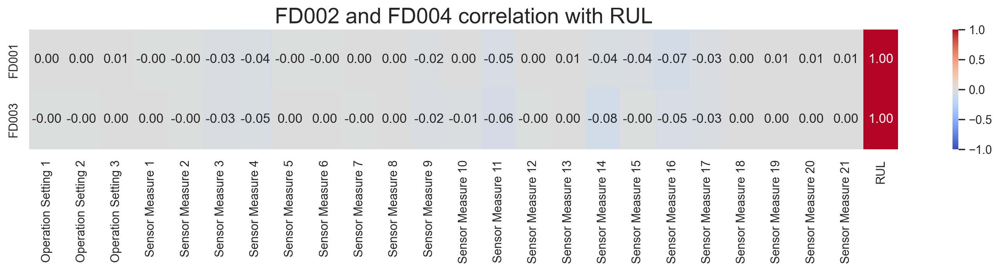

In [54]:
correlation_2 = train_data_2.drop(['UnitNumber', 'Cycle'], axis=1).corr()
correlation_4 = train_data_4.drop(['UnitNumber', 'Cycle'], axis=1).corr()

columns = pd.Index(['Dataset'])
columns.append(correlation_2.columns)
df_rul_2_4 = pd.DataFrame(columns=columns)
df_rul_2_4['FD001'] = correlation_2['RUL']
df_rul_2_4['FD003'] = correlation_4['RUL']

fig = plt.figure(figsize = (18,2))
sns.heatmap(df_rul_2_4[df_rul_2_4.columns.drop('Dataset')].transpose(), fmt=".2f", annot=True, vmin=-1, vmax=1, cmap="coolwarm")
plt.title('FD002 and FD004 correlation with RUL', fontsize=20)

Note: The findings above only describe the correlation between single values of the time series, not in the context of the previous values.

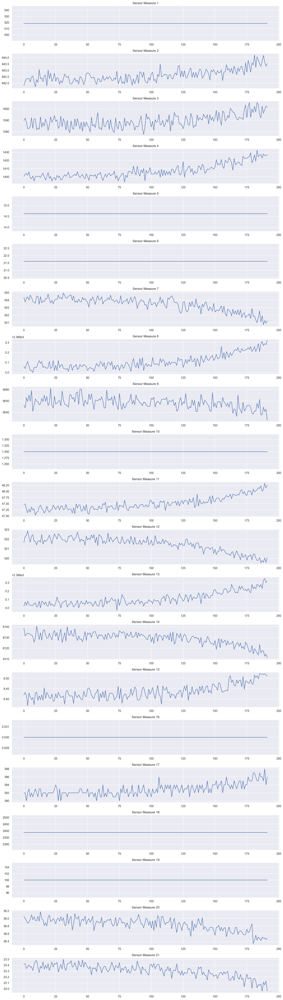

In [22]:
plot_sensor_measures_from_motor(config=config, motor_id=1, data=train_data_1, name_of_dataset='FD001', show=True, save=False)

Findings:
* The signal from Sensor Measure 1, 5, 6, 10, 16, 18, 19 has a constant value.
* For all other Sensor Measures, a change in the value around which they oscillate can be observed with a decrease in the RUL

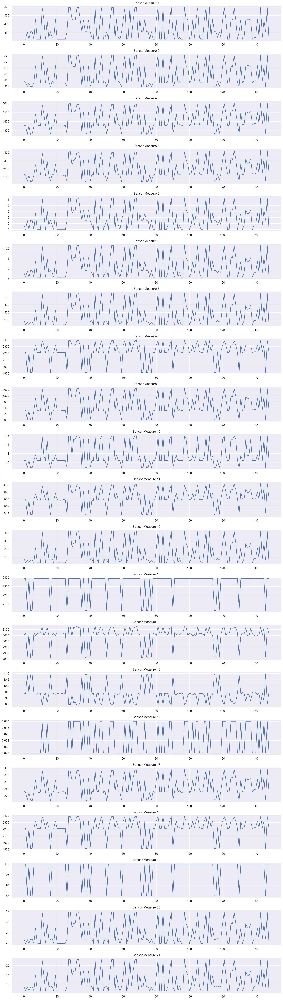

In [50]:
plot_sensor_measures_from_motor(config=config, motor_id=1, data=train_data_2, name_of_dataset='FD002', show=True, save=False)

Findings:
* Compared to the time series of motor 1 in the FD001 dataset all Sensor Measures are not constant
* The most Sensor Measures show oscillating patterns

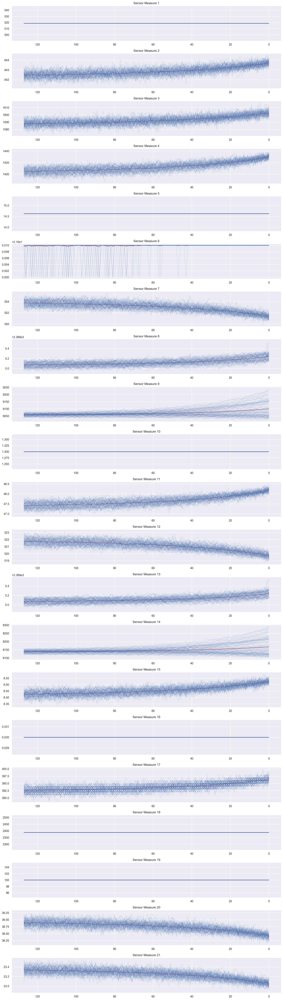

In [25]:
plot_sensor_measures_from_dataset(config=config, data=train_data_1, name_of_dataset='FD001', show=True, save=False)

for i, train_data_x in enumerate(train_data):
    plot_sensor_measures_from_dataset(config, train_data_x, 'FD00' + str(i + 1), show=False, save=True)

Findings: For FD001
* The signal from Sensor Measure 1, 5, 10, 16, 18, 19 has a constant value.
* The signal from Sensor Measure 6 does not have for all motors a constant value.
* The most Sensor Measures have a simalar behavior

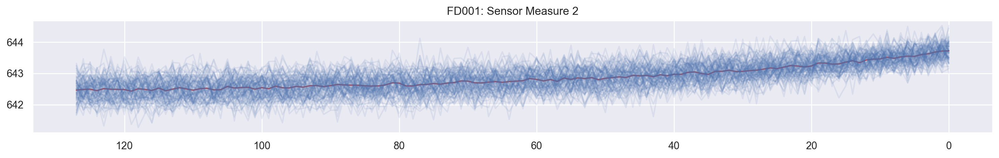

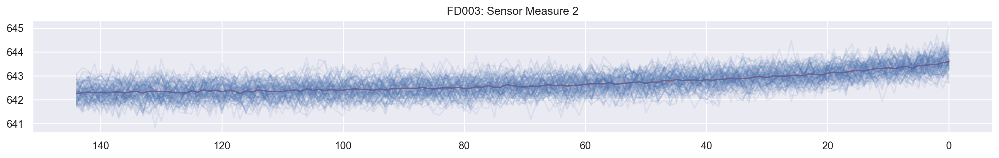

In [51]:
plot_single_sensor_measure_from_dataset(config=config, data=train_data_1, sensor_name='Sensor Measure 2', name_of_dataset='FD001', show=True, save=True)
plot_single_sensor_measure_from_dataset(config=config, data=train_data_3, sensor_name='Sensor Measure 2', name_of_dataset='FD003', show=True, save=True)

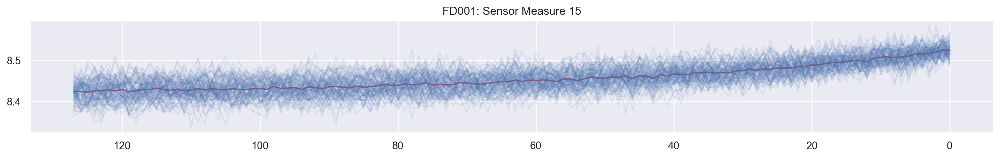

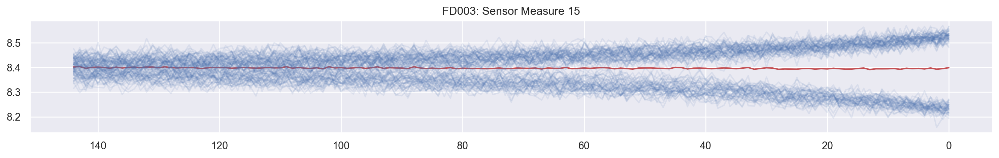

In [52]:
plot_single_sensor_measure_from_dataset(config=config, data=train_data_1, sensor_name='Sensor Measure 15', name_of_dataset='FD001', show=True, save=True)
plot_single_sensor_measure_from_dataset(config=config, data=train_data_3, sensor_name='Sensor Measure 15', name_of_dataset='FD003', show=True, save=True)

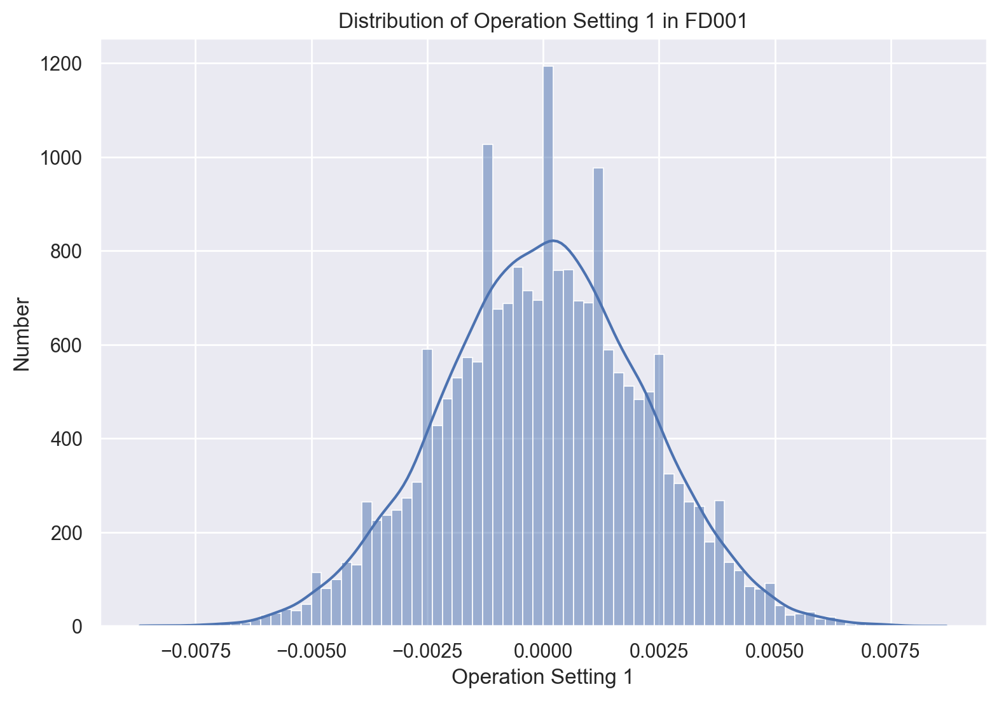

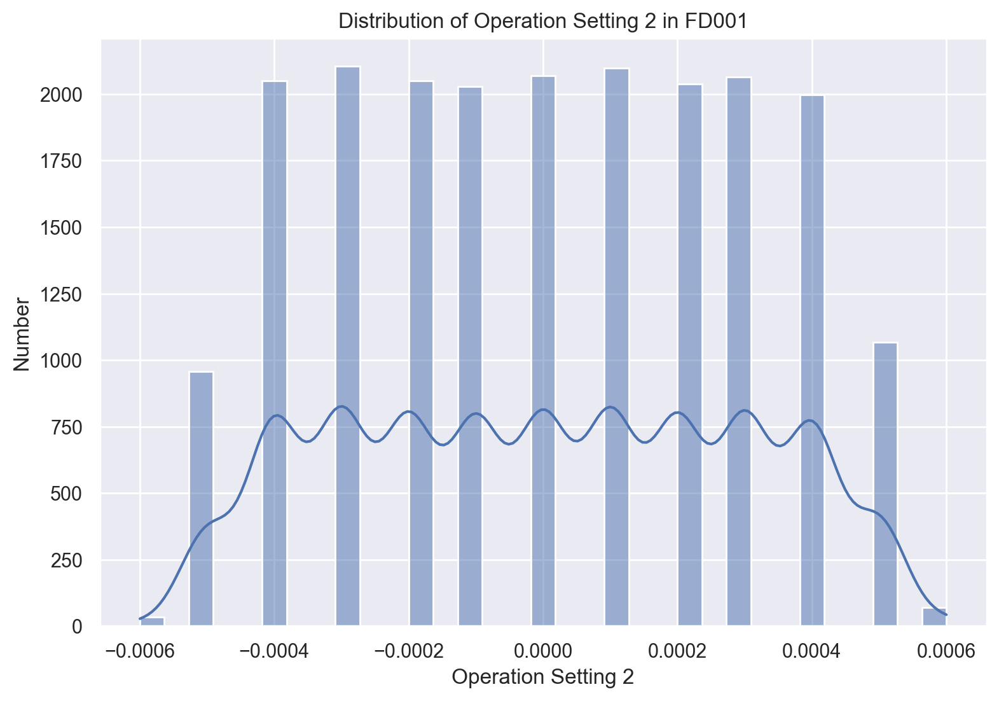

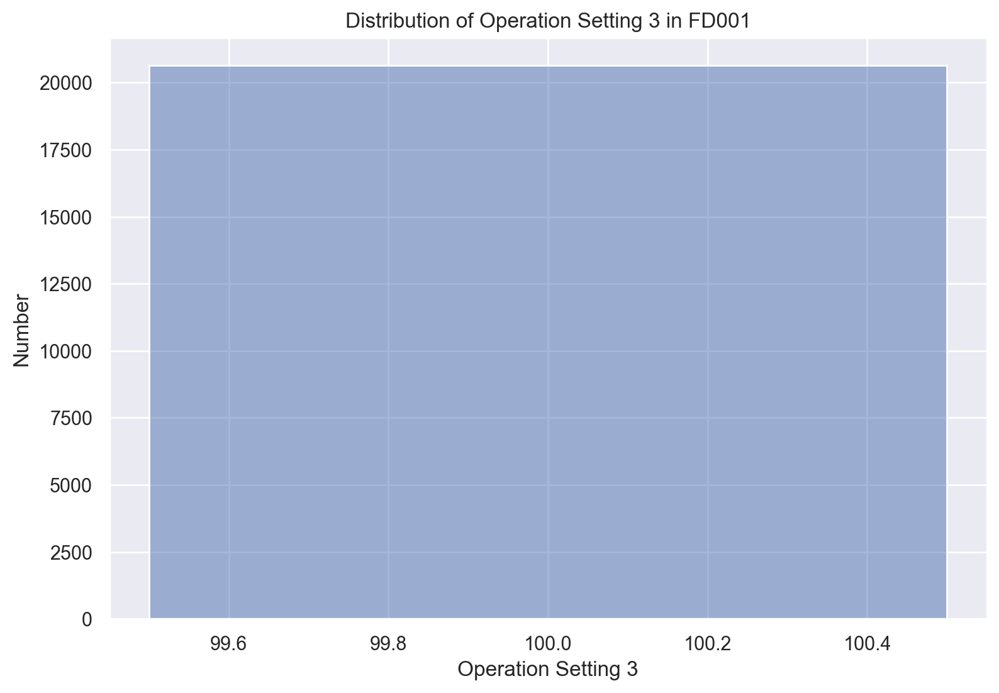

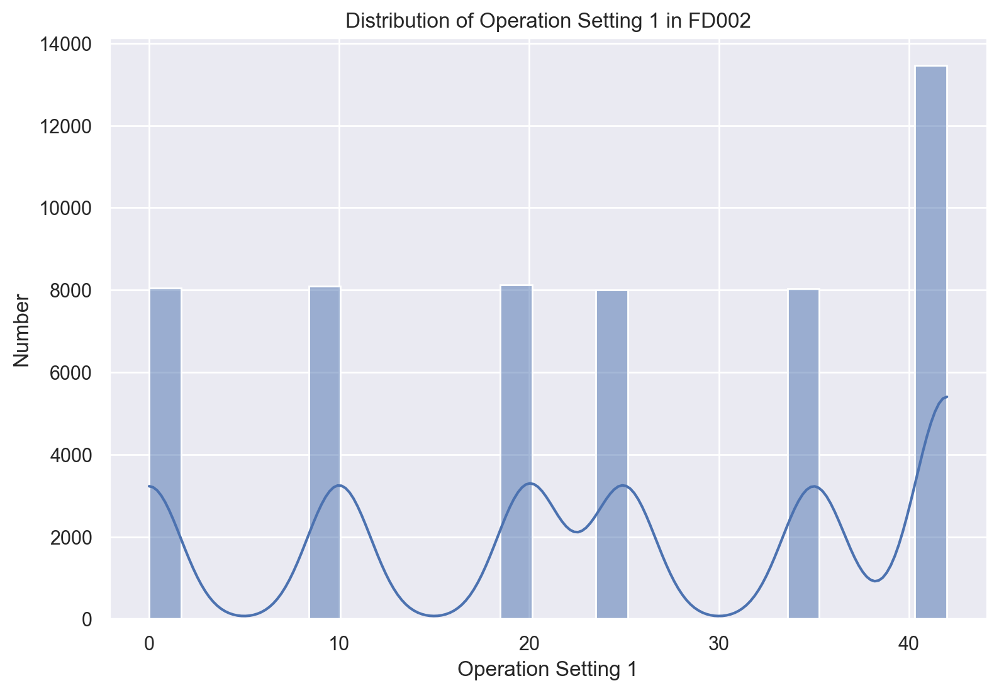

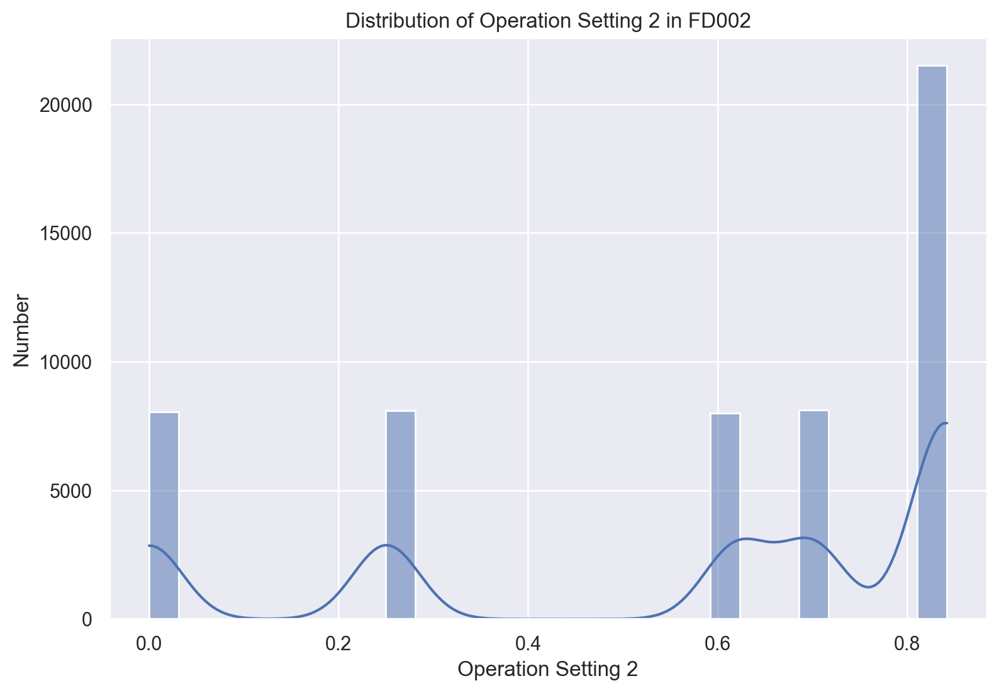

...

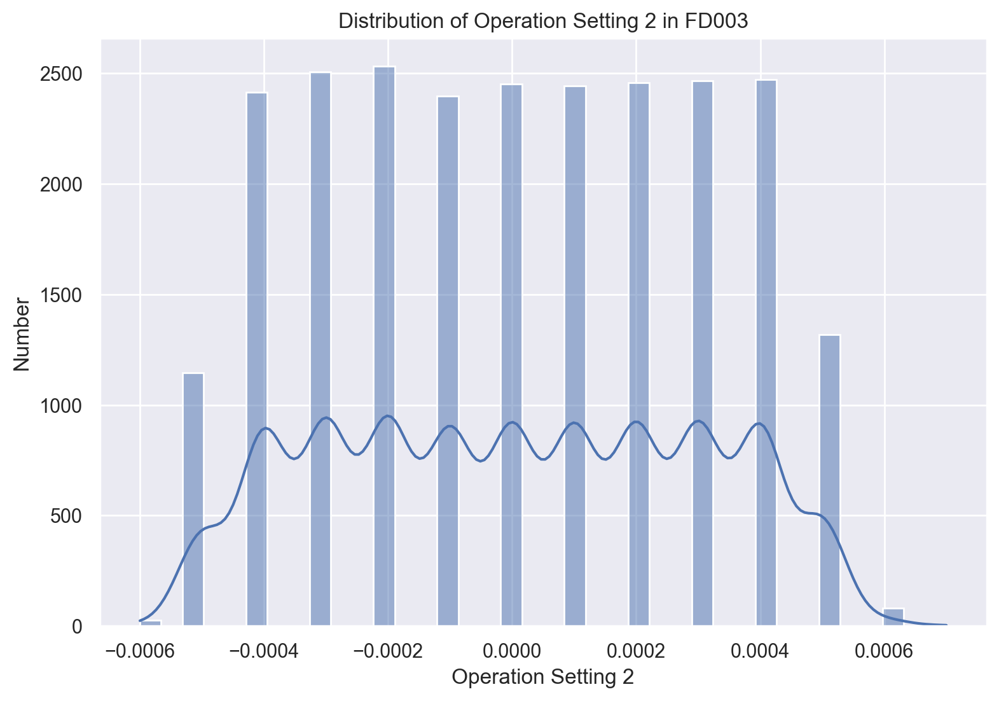

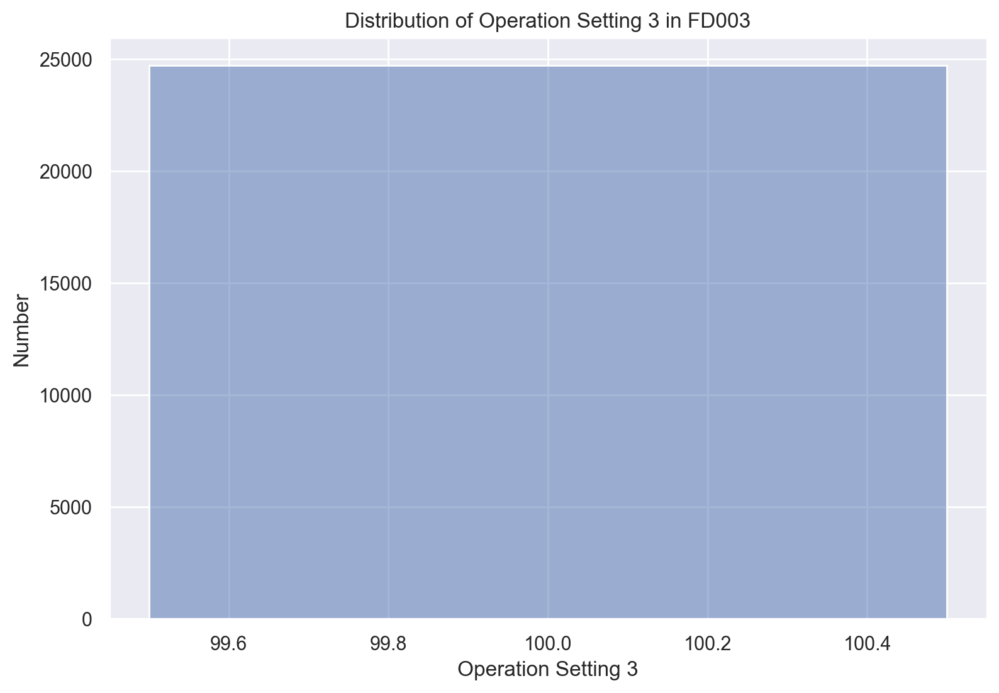

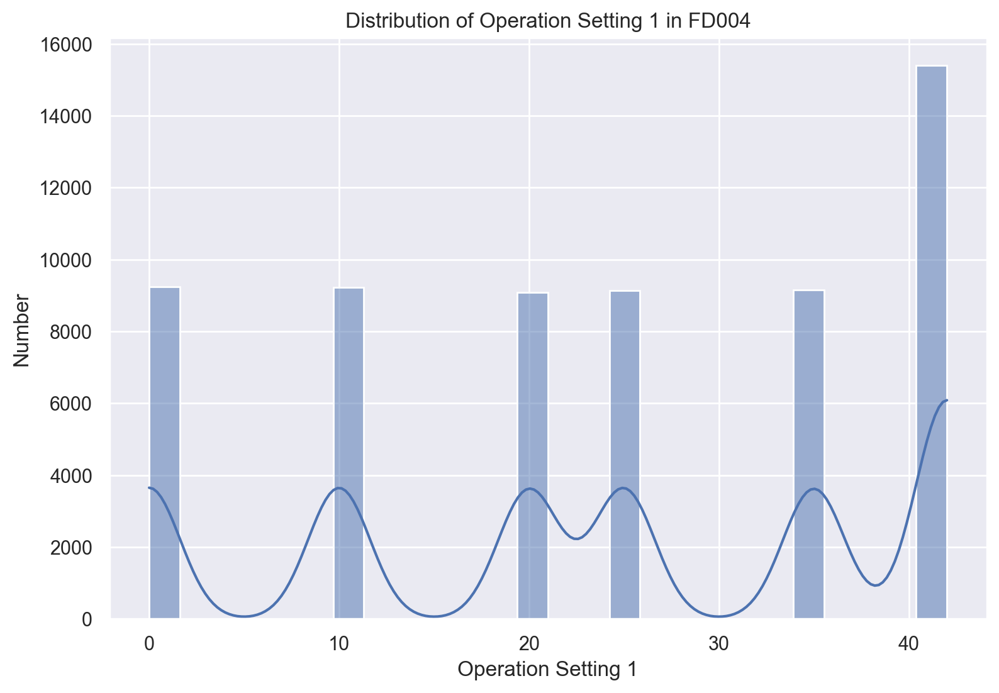

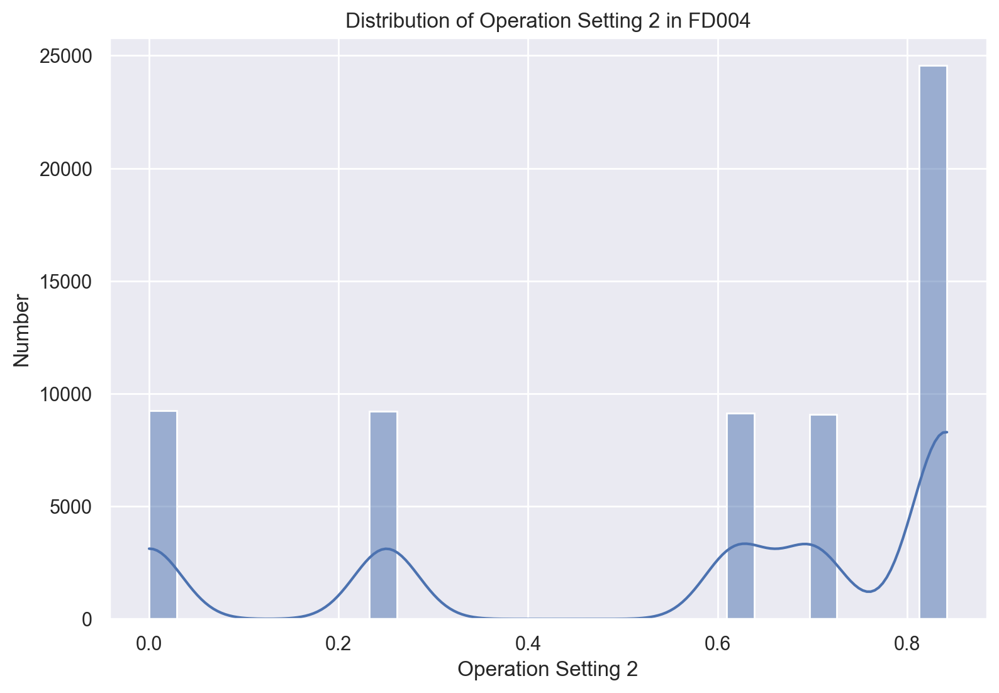

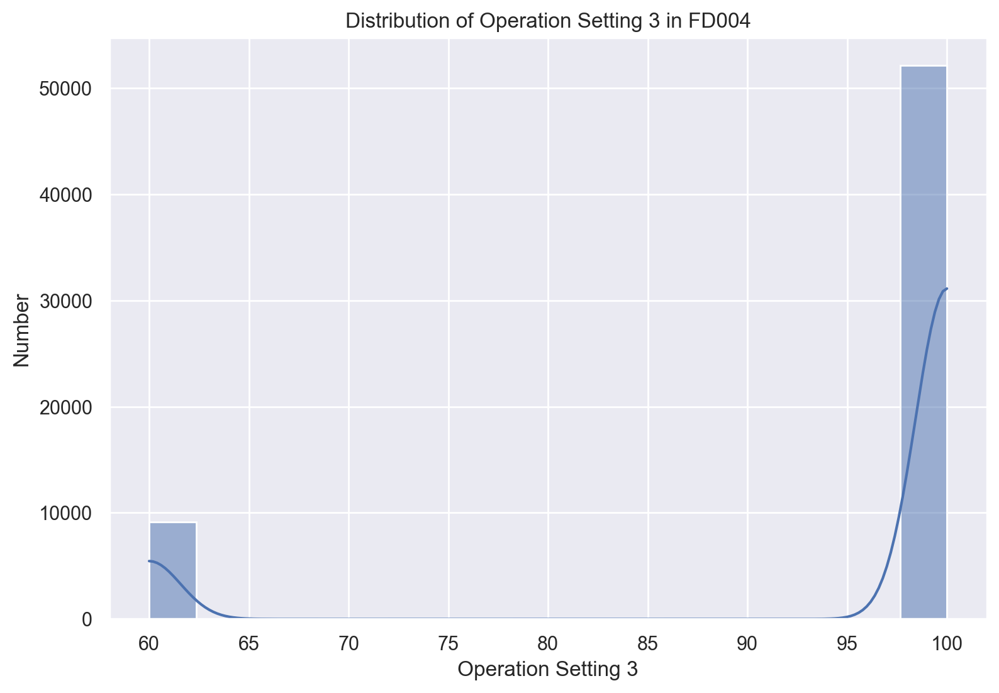

In [64]:

for i, train_data_x in enumerate(train_data):
    operation_settings = list(filter(lambda key: key.startswith('Operation'), train_data_x.keys()))
    for operation_setting in operation_settings:
        fig = plt.figure(figsize=(9, 6))
        sns.histplot(train_data_x[operation_setting], kde=True)
        name = 'Distribution of ' + operation_setting + ' in FD00' + str(i + 1)
        plt.title(name)
        plt.xlabel(operation_setting)
        plt.ylabel('Number')
        plt.show()
        timestamp = time.strftime("%Y%m%d-%H%M%S")
        fig.savefig(f"{config['paths']['plot_dir']}ex2_{name}_{timestamp}.png")

Findings: TODO!

Preprocessing: Savitzky-Golay Filter, TODO: Delete?

In [20]:
from scipy.signal import savgol_filter
# TODO: Add comments
def convert_sensor_signals_with_savgol(data, sensor_measure_columns_names, window_length, polyorder, deriv=0):
    data_savgol = data.copy()
    for sensor_measure_column_name in sensor_measure_columns_names:
        data_savgol[sensor_measure_column_name] = data.groupby('UnitNumber')[sensor_measure_column_name].transform(lambda x: savgol_filter(x, window_length=window_length, polyorder=polyorder, deriv=deriv))
    return data_savgol

In [ ]:
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_1.keys()))
train_data_1_savgol = convert_sensor_signals_with_savgol(train_data_1, sensor_measure_columns_names, window_length=5, polyorder=2)

plot_sensor_measures_from_dataset(train_data=train_data_1_savgol, name_of_dataset='FD001', show=True, save=False)

In [ ]:
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_2.keys()))
train_data_2_savgol = convert_sensor_signals_with_savgol(train_data_2, sensor_measure_columns_names, window_length=10, polyorder=2)

plot_sensor_measures_from_dataset(train_data=train_data_2_savgol, name_of_dataset='FD002', show=True, save=False)

In [20]:
def plot_sensor_measures_from_dataset(train_data, name_of_dataset, show=True, save=False):
    sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data.keys()))
    number_of_columns = len(sensor_measure_columns_names)
    fig = plt.figure(figsize=(15,2.5*len(sensor_measure_columns_names)))
    for i,v in enumerate(range(number_of_columns)):
        a = plt.subplot(number_of_columns,1,v+1)
        min_rul = train_data.groupby("UnitNumber")["RUL"].max().min()
        #a.plot(range(min_rul), train_data_1[train_data_1["RUL"] <= min_rul].groupby("RUL")[sensor_measure_columns_names[v]].mean(), color='r')
        for motor_id in train_data['UnitNumber'].unique():
            a.plot(range(min_rul-1, -1, -1), train_data[train_data["UnitNumber"]==motor_id][sensor_measure_columns_names[v]][-min_rul:], alpha=0.1, color='b')
        a.invert_xaxis()
        a.title.set_text(sensor_measure_columns_names[v])
        plt.tight_layout()
    if show:
        plt.show()
    if save:
        timestamp = time.strftime("%Y%m%d-%H%M%S")
        fig.savefig(f"{config['paths']['plot_dir']}ex2_topic_dataset_{name_of_dataset}_{timestamp}.png")
    plt.close()

In [ ]:
sensor_measure_columns_names = list(filter(lambda x: x.startswith('Sensor'), train_data_1.keys()))
train_data_1_savgol_1 = convert_sensor_signals_with_savgol(train_data_1, sensor_measure_columns_names, window_length=5, polyorder=2, deriv=1)

plot_sensor_measures_from_dataset(train_data=train_data_1_savgol_1, name_of_dataset='FD001', show=True, save=False)

### Inspect peaks of sensor signal

In [63]:
from scipy.signal import find_peaks

values = train_data_1[train_data_1['UnitNumber'] == 1]['Sensor Measure 2'].values
peaks = find_peaks(values)
print(peaks)
count_of_peaks = np.zeros(values.shape)
count_of_peaks[peaks[0]] = 1
count_of_peaks = np.cumsum(count_of_peaks)
print(count_of_peaks)
rul = train_data_1[train_data_1['UnitNumber'] == 1]['RUL'].values
np.corrcoef(count_of_peaks, rul)

(array([  4,   7,  10,  12,  14,  17,  19,  21,  24,  26,  29,  32,  35,
        40,  42,  44,  50,  55,  59,  62,  65,  67,  71,  73,  76,  78,
        80,  82,  86,  89,  91,  94,  98, 101, 103, 105, 107, 110, 112,
       114, 119, 122, 124, 126, 131, 133, 135, 138, 143, 147, 149, 152,
       155, 159, 161, 163, 165, 168, 171, 174, 176, 179, 181, 183, 188],
      dtype=int64), {})
[ 0.  0.  0.  0.  1.  1.  1.  2.  2.  2.  3.  3.  4.  4.  5.  5.  5.  6.
  6.  7.  7.  8.  8.  8.  9.  9. 10. 10. 10. 11. 11. 11. 12. 12. 12. 13.
 13. 13. 13. 13. 14. 14. 15. 15. 16. 16. 16. 16. 16. 16. 17. 17. 17. 17.
 17. 18. 18. 18. 18. 19. 19. 19. 20. 20. 20. 21. 21. 22. 22. 22. 22. 23.
 23. 24. 24. 24. 25. 25. 26. 26. 27. 27. 28. 28. 28. 28. 29. 29. 29. 30.
 30. 31. 31. 31. 32. 32. 32. 32. 33. 33. 33. 34. 34. 35. 35. 36. 36. 37.
 37. 37. 38. 38. 39. 39. 40. 40. 40. 40. 40. 41. 41. 41. 42. 42. 43. 43.
 44. 44. 44. 44. 44. 45. 45. 46. 46. 47. 47. 47. 48. 48. 48. 48. 48. 49.
 49. 49. 49. 50. 50. 51. 51. 5

array([[ 1.        , -0.99933244],
       [-0.99933244,  1.        ]])

In [68]:
# TODO: Change method name and method signuture 
def extract_peaks_from_sensor_signal(dataframe, sensor_measure_columns_names):
    motor_ids = dataframe['UnitNumber'].unique()
    for motor_id in motor_ids:
        for sensor_measure_column_name in sensor_measure_columns_names:
            values = dataframe[dataframe['UnitNumber'] == motor_id][sensor_measure_column_name].values
            peaks = find_peaks(values)
            count_of_peaks = np.zeros(values.shape)
            count_of_peaks[peaks[0]] = 1
            count_of_peaks = np.cumsum(count_of_peaks)
            dataframe.iloc[dataframe['UnitNumber'] == motor_id][sensor_measure_column_name + ' Peaks'] = count_of_peaks

train_data_1_peaks = extract_peaks_from_sensor_signal(train_data_1, sensor_measure_columns_names)

C:\Users\Johannes\AppData\Local\Temp\ipykernel_20296\998279414.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe[dataframe['UnitNumber'] == motor_id][sensor_measure_column_name + ' Peaks'] = count_of_peaks
C:\Users\Johannes\AppData\Local\Temp\ipykernel_20296\998279414.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataframe[dataframe['UnitNumber'] == motor_id][sensor_measure_column_name + ' Peaks'] = count_of_peaks
C:\Users\Johannes\AppData\Local\Temp\ipykernel_20296\998279414.py:11: Sett

In [61]:
values = train_data_1_savgol[train_data_1_savgol['UnitNumber'] == 1]['Sensor Measure 2'].values
peaks = find_peaks(values)
print(peaks)
count_of_peaks = np.zeros(values.shape)
count_of_peaks[peaks[0]] = 1
count_of_peaks = np.cumsum(count_of_peaks)
print(count_of_peaks)
rul = train_data_1[train_data_1['UnitNumber'] == 1]['RUL'].values
np.corrcoef(count_of_peaks, rul)

(array([  3,   7,  13,  16,  20,  24,  32,  40,  45,  50,  54,  59,  62,
        67,  72,  76,  83,  92, 101, 107, 111, 115, 121, 125, 130, 134,
       138, 143, 148, 154, 160, 162, 165, 171, 176, 180, 182, 184, 188],
      dtype=int64), {})
[ 0.  0.  0.  1.  1.  1.  1.  2.  2.  2.  2.  2.  2.  3.  3.  3.  4.  4.
  4.  4.  5.  5.  5.  5.  6.  6.  6.  6.  6.  6.  6.  6.  7.  7.  7.  7.
  7.  7.  7.  7.  8.  8.  8.  8.  8.  9.  9.  9.  9.  9. 10. 10. 10. 10.
 11. 11. 11. 11. 11. 12. 12. 12. 13. 13. 13. 13. 13. 14. 14. 14. 14. 14.
 15. 15. 15. 15. 16. 16. 16. 16. 16. 16. 16. 17. 17. 17. 17. 17. 17. 17.
 17. 17. 18. 18. 18. 18. 18. 18. 18. 18. 18. 19. 19. 19. 19. 19. 19. 20.
 20. 20. 20. 21. 21. 21. 21. 22. 22. 22. 22. 22. 22. 23. 23. 23. 23. 24.
 24. 24. 24. 24. 25. 25. 25. 25. 26. 26. 26. 26. 27. 27. 27. 27. 27. 28.
 28. 28. 28. 28. 29. 29. 29. 29. 29. 29. 30. 30. 30. 30. 30. 30. 31. 31.
 32. 32. 32. 33. 33. 33. 33. 33. 33. 34. 34. 34. 34. 34. 35. 35. 35. 35.
 36. 36. 37. 37. 38. 38. 38.

array([[ 1.        , -0.99753929],
       [-0.99753929,  1.        ]])

Findings: TODO